In [54]:

import torch
import cv2

import imagenet_stubs
from torchvision.transforms import transforms
import PIL.Image
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm

CLASSES = [
    'N/A', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack',
    'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A',
    'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]


MEAN = [0.485, 0.456, 0.406]
STD = [0.229, 0.224, 0.225]
normalize = transforms.Normalize(mean=MEAN,
                                 std=STD)

transform = transforms.Compose([
        transforms.Resize(800, interpolation=transforms.InterpolationMode.BICUBIC),
        transforms.CenterCrop(800),
        transforms.ToTensor(),
        normalize,
    ])
    
in_images = []
out_images = []
for image_path in imagenet_stubs.get_image_paths():
    im = PIL.Image.open(image_path).convert('RGB')
    in_images.append(im)
    im = transform(im).numpy()
    out_images.append(im)
images = np.array(out_images)

def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

def extract_predictions(predictions_, conf_thresh):
    # Get the predicted class
    predictions_class = [CLASSES[i] for i in list(predictions_["labels"])]
    #  print("\npredicted classes:", predictions_class)
    if len(predictions_class) < 1:
        return [], [], []
    # Get the predicted bounding boxes
    predictions_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(predictions_["boxes"])]

    # Get the predicted prediction score
    predictions_score = list(predictions_["scores"])
    # print("predicted score:", predictions_score)

    # Get a list of index with score greater than threshold
    threshold = conf_thresh
    predictions_t = [predictions_score.index(x) for x in predictions_score if x > threshold]
    if len(predictions_t) > 0:
        predictions_t = predictions_t  # [-1] #indices where score over threshold
    else:
        # no predictions esxceeding threshold
        return [], [], []
    # predictions in score order
    predictions_boxes = [predictions_boxes[i] for i in predictions_t]
    predictions_class = [predictions_class[i] for i in predictions_t]
    predictions_scores = [predictions_score[i] for i in predictions_t]
    return predictions_class, predictions_boxes, predictions_scores


def plot_image_with_boxes(img, boxes, pred_cls, title):
    text_size = 2
    text_th = 2
    rect_th = 2

    for i in range(len(boxes)):
        cv2.rectangle(img, (int(boxes[i][0][0]), int(boxes[i][0][1])), (int(boxes[i][1][0]), int(boxes[i][1][1])),
                      color=(0, 255, 0), thickness=rect_th)
        # Write the prediction class
        cv2.putText(img, pred_cls[i], (int(boxes[i][0][0]), int(boxes[i][0][1])), cv2.FONT_HERSHEY_SIMPLEX, text_size,
                    (0, 255, 0), thickness=text_th)

    plt.figure()
    plt.axis("off")
    plt.title(title)
    plt.imshow(img, interpolation="nearest")


In [289]:
type(model)

models.detr.DETR

In [2]:
model = torch.hub.load('facebookresearch/detr', 'detr_resnet50', pretrained=True)

Using cache found in /Users/kieranfraser/.cache/torch/hub/facebookresearch_detr_main
/Users/kieranfraser/git/personal/art/env/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/kieranfraser/git/personal/art/env/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [262]:
outputs = model(torch.from_numpy(images))

In [109]:
im = PIL.Image.fromarray((images[0].transpose(1,2,0)*255).astype(np.uint8), mode='RGB')

In [283]:
invTrans(torch.from_numpy(images))[0].numpy().shape

(3, 800, 800)

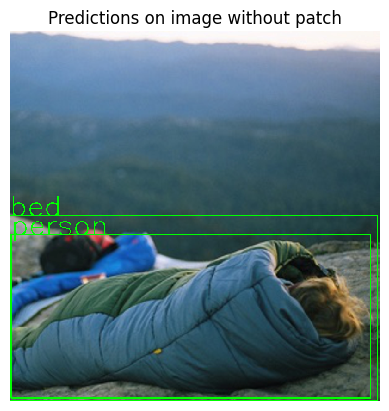

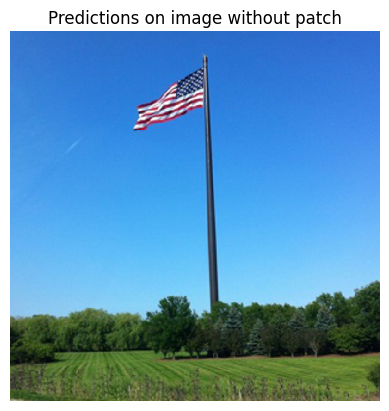

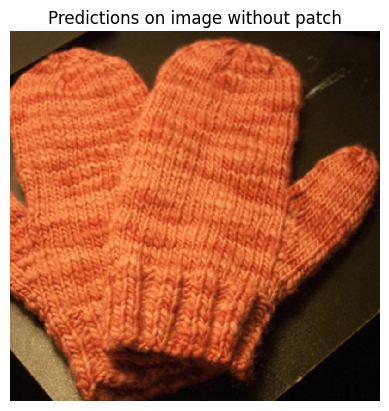

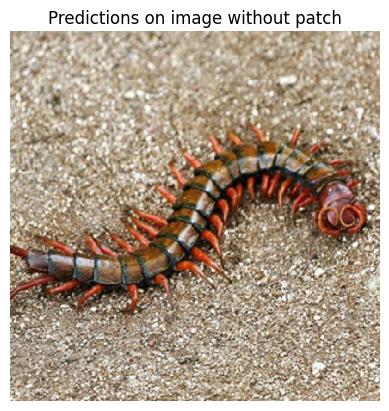

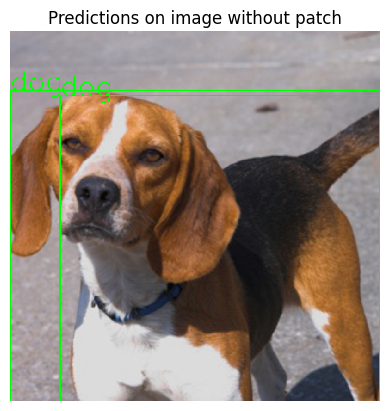

...

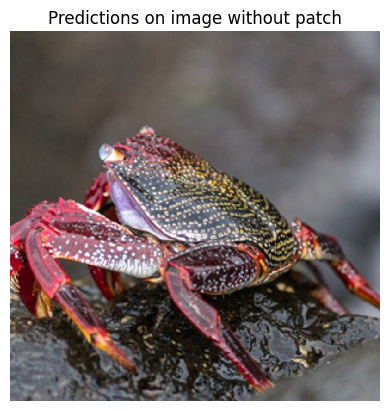

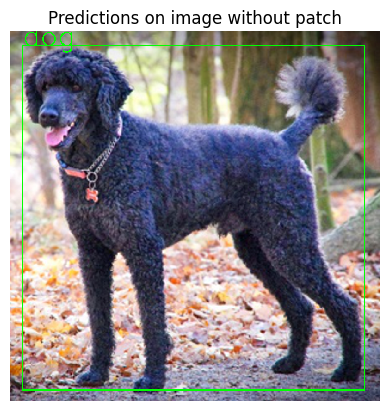

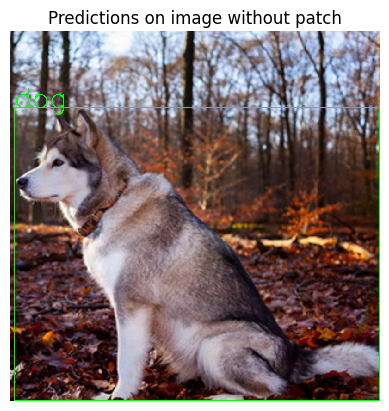

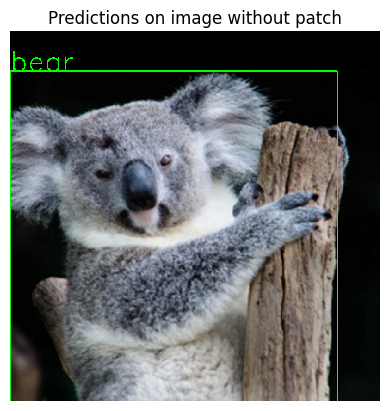

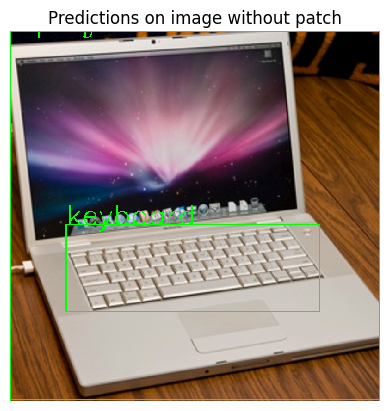

In [287]:
invTrans = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ],
                                                     std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                                transforms.Normalize(mean = [ -0.485, -0.456, -0.406 ],
                                                     std = [ 1., 1., 1. ]),
                               ])

outputs['labels'] = outputs['pred_logits'].softmax(-1)[:, :, :-1].argmax(axis=0)

results = []
for i in range(images.shape[0]):
    results.append({
        'boxes': rescale_bboxes(outputs['pred_boxes'][i,:,:], (800,800)).detach().numpy(),
        'scores': outputs['pred_logits'][i, :, :].unsqueeze(0).softmax(-1)[0, :, :-1].max(dim=1)[0].detach().numpy(),
        'labels': outputs['pred_logits'][i, :, :].unsqueeze(0).softmax(-1)[0, :, :-1].max(dim=1)[1].detach().numpy()
    })

for i in range(len(results)):
    preds = extract_predictions(results[i], 0.8)
    im = (invTrans(torch.from_numpy(images))[i].numpy().transpose(1,2,0)*255).astype(np.uint8)
    plot_image_with_boxes(img=im.astype(np.uint8).copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")

Found annotations at '/Users/kieranfraser/fiftyone/coco-2017/raw/instances_val2017.json'
Sufficient images already downloaded
Existing download of split 'validation' is sufficient
Loading existing dataset 'coco-2017-validation-30'. To reload from disk, either delete the existing dataset or provide a custom `dataset_name` to use


/var/folders/n3/v54cywm557s4812yt0fw85240000gn/T/ipykernel_6314/3621607881.py:102: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


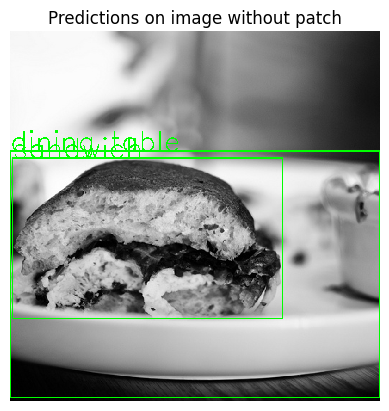

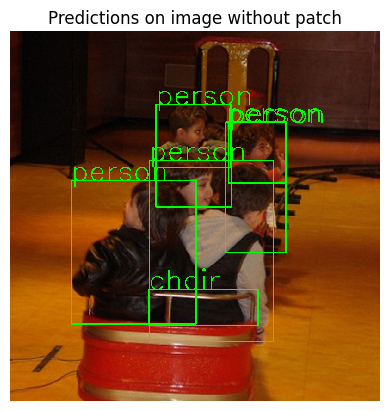

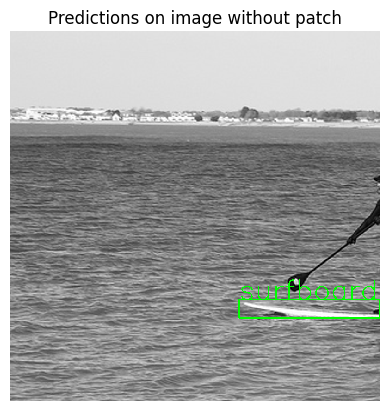

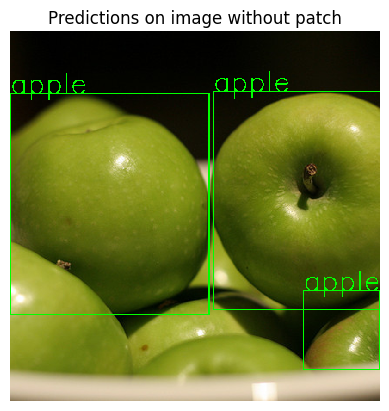

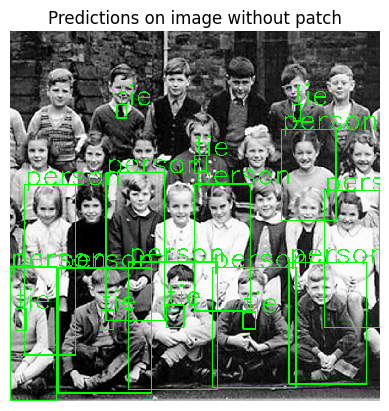

...

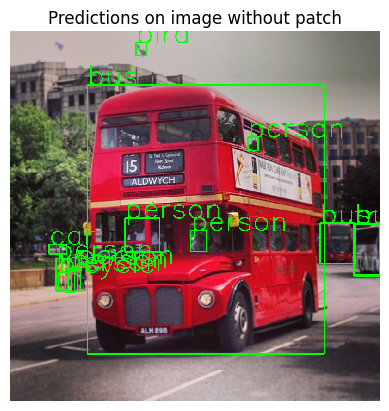

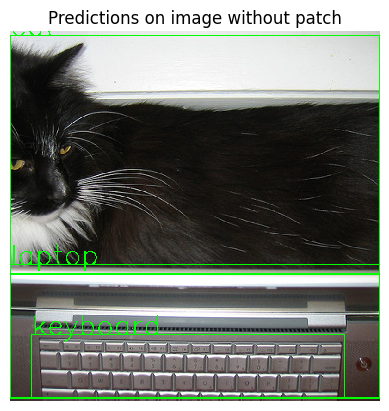

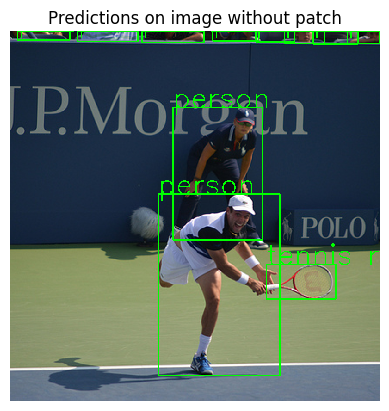

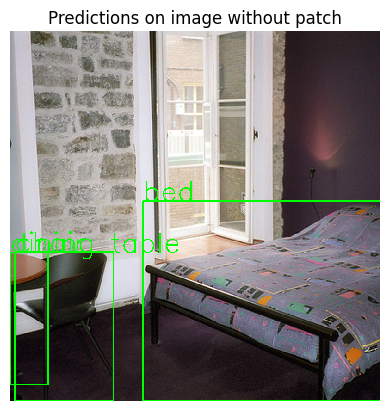

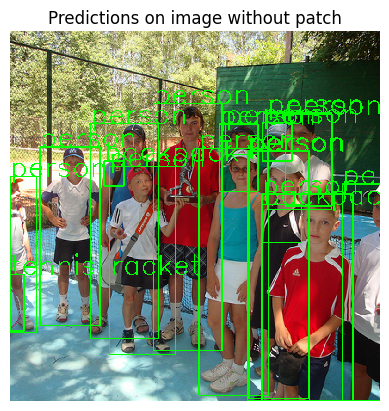

In [260]:
import fiftyone as fo
coco_data = fo.zoo.load_zoo_dataset('coco-2017', split='validation', label_types=['detections'], max_samples=30)
coco_data.compute_metadata()

MEAN = [0.485, 0.456, 0.406]
STD = [0.229, 0.224, 0.225]
normalize = transforms.Normalize(mean=MEAN,
                                 std=STD)

transform = transforms.Compose([
        transforms.Resize(800, interpolation=transforms.InterpolationMode.BICUBIC),
        transforms.CenterCrop(800),
        transforms.ToTensor(),
        normalize,
    ])

t2 = transforms.Compose([
    transforms.Resize(800, interpolation=transforms.InterpolationMode.BICUBIC),
    transforms.CenterCrop(800),
    transforms.ToTensor(),
    #normalize,
])


data = coco_data.take(30)
in_images = []
out_images = []
t2_out_images = []
for f in data.values('filepath'):
    im = PIL.Image.open(f).convert('RGB')
    in_images.append(im)
    t2_out_images.append(t2(im))
    im = transform(im).numpy()
    out_images.append(im)
images = np.array(out_images)

outputs = model(torch.from_numpy(images))
outputs['labels'] = outputs['pred_logits'].softmax(-1)[:, :, :-1].argmax(axis=0)

results = []
for i in range(images.shape[0]):
    results.append({
        'boxes': rescale_bboxes(outputs['pred_boxes'][i,:,:], (800,800)).detach().numpy(),
        'scores': outputs['pred_logits'][i, :, :].unsqueeze(0).softmax(-1)[0, :, :-1].max(dim=1)[0].detach().numpy(),
        'labels': outputs['pred_logits'][i, :, :].unsqueeze(0).softmax(-1)[0, :, :-1].max(dim=1)[1].detach().numpy()
    })

t2_images = np.array([i.numpy() for i in t2_out_images])
for i in range(len(results)):
    preds = extract_predictions(results[i], 0.8)
    im = (t2_images[i].transpose(1,2,0)*255).astype(np.uint8)
    plot_image_with_boxes(img=im.astype(np.uint8).copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")

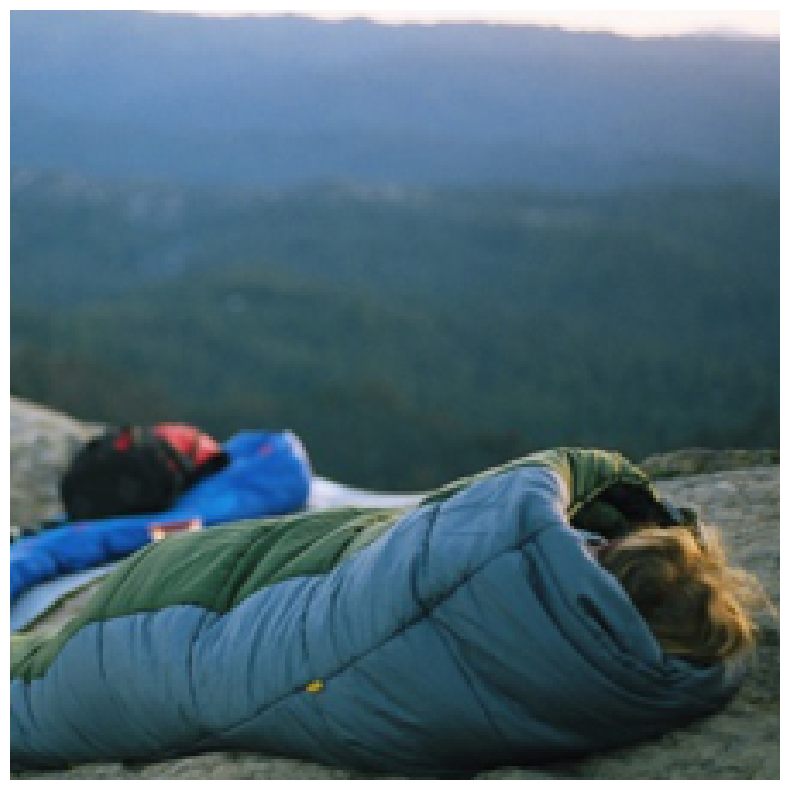

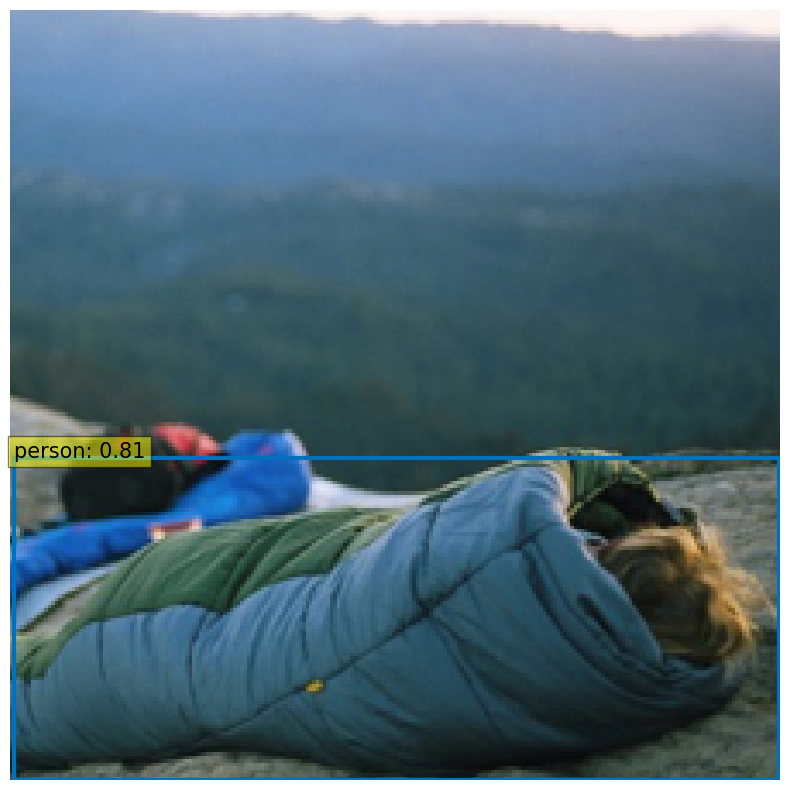

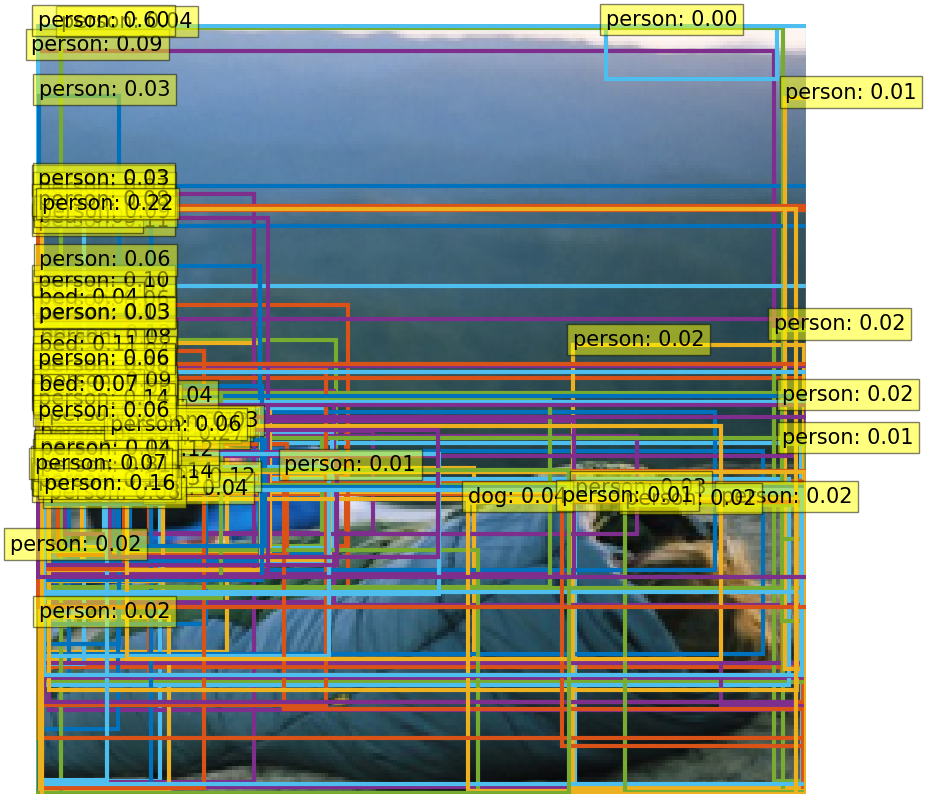

In [6]:
# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

def filter_bboxes_from_outputs(outputs,
                               threshold=0.7):
  
  # keep only predictions with confidence above threshold
  probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  probas_to_keep = probas[keep]

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
  
  return probas_to_keep, bboxes_scaled

import matplotlib.pyplot as plt

def plot_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
      for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
          cl = p.argmax()
          text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
          ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

# COCO classes
CLASSES = [
    'N/A', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack',
    'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A',
    'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]

# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

for threshold in [0.9, 0.7, 0.0]:

    probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                            threshold=threshold)

    plot_results(im, probas_to_keep, bboxes_scaled)

In [33]:
from typing import Optional

In [34]:
Optional["models.detr.DETR"]

typing.Optional[ForwardRef('models.detr.DETR')]

In [32]:
type(model)

models.detr.DETR

# Testing ART

In [1]:
from art.estimators.object_detection.pytorch_detr import PyTorchDetectionTransformer
import imagenet_stubs
from torchvision.transforms import transforms
import PIL.Image
import numpy as np
import torch
import cv2
import matplotlib.pyplot as plt

def extract_predictions(predictions_, conf_thresh):
    # Get the predicted class
    predictions_class = [CLASSES[i] for i in list(predictions_["labels"])]
    #  print("\npredicted classes:", predictions_class)
    if len(predictions_class) < 1:
        return [], [], []
    # Get the predicted bounding boxes
    predictions_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(predictions_["boxes"])]

    # Get the predicted prediction score
    predictions_score = list(predictions_["scores"])
    # print("predicted score:", predictions_score)

    # Get a list of index with score greater than threshold
    threshold = conf_thresh
    predictions_t = [predictions_score.index(x) for x in predictions_score if x > threshold]
    if len(predictions_t) > 0:
        predictions_t = predictions_t  # [-1] #indices where score over threshold
    else:
        # no predictions esxceeding threshold
        return [], [], []
    # predictions in score order
    predictions_boxes = [predictions_boxes[i] for i in predictions_t]
    predictions_class = [predictions_class[i] for i in predictions_t]
    predictions_scores = [predictions_score[i] for i in predictions_t]
    return predictions_class, predictions_boxes, predictions_scores

def plot_image_with_boxes(img, boxes, pred_cls, title):
    text_size = 2
    text_th = 2
    rect_th = 2

    for i in range(len(boxes)):
        cv2.rectangle(img, (int(boxes[i][0][0]), int(boxes[i][0][1])), (int(boxes[i][1][0]), int(boxes[i][1][1])),
                      color=(0, 255, 0), thickness=rect_th)
        # Write the prediction class
        cv2.putText(img, pred_cls[i], (int(boxes[i][0][0]), int(boxes[i][0][1])), cv2.FONT_HERSHEY_SIMPLEX, text_size,
                    (0, 255, 0), thickness=text_th)

    plt.figure()
    plt.axis("off")
    plt.title(title)
    plt.imshow(img)

invTrans = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ],
                                                     std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                                transforms.Normalize(mean = [ -0.485, -0.456, -0.406 ],
                                                     std = [ 1., 1., 1. ]),
                               ])

CLASSES = [
    'N/A', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A',
    'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack',
    'umbrella', 'N/A', 'N/A', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis',
    'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'N/A', 'wine glass',
    'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake',
    'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table', 'N/A',
    'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
    'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A',
    'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier',
    'toothbrush'
]


MEAN = [0.485, 0.456, 0.406]
STD = [0.229, 0.224, 0.225]
normalize = transforms.Normalize(mean=MEAN,
                                 std=STD)

transform = transforms.Compose([
        transforms.Resize(800, interpolation=transforms.InterpolationMode.BICUBIC),
        transforms.CenterCrop(800),
        transforms.ToTensor(),
        normalize,
    ])
    
in_images = []
out_images = []
for image_path in imagenet_stubs.get_image_paths():
    im = PIL.Image.open(image_path).convert('RGB')
    in_images.append(im)
    im = transform(im).numpy()
    out_images.append(im)
images = np.array(out_images)

In [2]:
detector = PyTorchDetectionTransformer(channels_first=True)

Using cache found in /Users/kieranfraser/.cache/torch/hub/facebookresearch_detr_main
/Users/kieranfraser/git/personal/art/env/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users/kieranfraser/git/personal/art/env/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [53]:
import requests
url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
im = PIL.Image.open(requests.get(url, stream=True).raw)
im = transform(im).unsqueeze(0).numpy()

/Users/kieranfraser/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


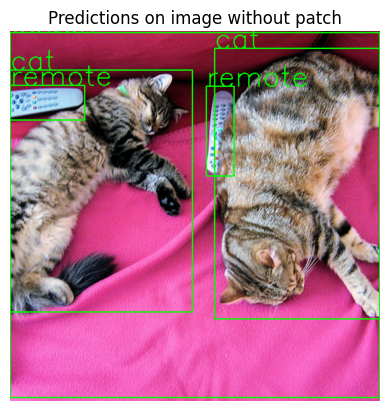

In [54]:
results = detector.predict(im)
for i in range(len(results)):
    preds = extract_predictions(results[i], 0.8)
    im = (invTrans(torch.from_numpy(im))[i].numpy().transpose(1,2,0)*255).astype(np.uint8)
    plot_image_with_boxes(img=im.copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")

In [36]:
results = detector.predict(images[[4]])

In [37]:
results[0]['labels']

tensor([ 1, 41, 41,  1, 18, 18, 34, 34,  1, 18, 41,  1, 18, 27, 34, 18, 34, 15,
        27, 18, 41,  1,  1, 27,  1, 41,  1, 15,  1,  1,  1, 34, 34, 27,  1, 34,
         1, 18, 34, 27,  1,  1, 18, 18, 18, 18,  1, 41,  1, 34,  1, 18, 41, 18,
        34, 18, 34, 41, 18, 18, 18, 18, 15, 34, 15, 34, 34, 18, 34, 27, 15, 18,
        18, 41, 41, 18, 18,  1,  1, 34,  1, 34,  1, 15, 34, 41, 27, 18,  9, 41,
        18,  1, 18, 41, 41, 41, 34, 15, 18, 18])

In [9]:
results[0]['labels']

tensor([27,  1, 65,  1,  1,  1,  1, 44,  1, 65, 65, 27, 65, 65, 65,  1, 27, 18,
        18, 65, 65,  1, 65,  1, 18,  1, 65,  1,  1,  1,  1, 65, 65, 27, 65,  1,
         1,  1, 44, 18, 18, 65,  1, 65, 27,  1, 18,  1,  1, 27,  1, 18, 65,  1,
         1,  1, 27,  1,  1,  1,  1,  1, 65,  1, 65, 44,  1, 65,  1, 27, 27,  1,
        65,  1, 65,  1,  1, 27,  1, 27, 65,  1,  1,  1,  1, 65, 27,  1, 65,  1,
         1, 18,  1,  1,  1, 65, 27,  1,  1, 18])

In [35]:
detector._get_losses(images[[4]], results)

({'loss_ce': tensor(7.9082, grad_fn=<NllLoss2DBackward0>),
  'class_error': tensor(98.),
  'loss_bbox': tensor(1727.7830, grad_fn=<DivBackward0>),
  'loss_giou': tensor(1.1890, grad_fn=<DivBackward0>),
  'cardinality_error': tensor(98.)},
 tensor([[[[ 0.7248,  0.7248,  0.7248,  ...,  0.4337,  0.4508,  0.4337],
           [ 0.7248,  0.7248,  0.7248,  ...,  0.4337,  0.4508,  0.4508],
           [ 0.7077,  0.7077,  0.7077,  ...,  0.4508,  0.4679,  0.4679],
           ...,
           [ 0.8447,  0.8447,  0.8789,  ...,  0.5536,  0.7248,  0.8104],
           [ 0.8276,  0.8447,  0.8789,  ...,  0.6221,  0.7933,  0.8789],
           [ 0.8276,  0.8447,  0.8789,  ...,  0.6392,  0.8104,  0.8961]],
 
          [[ 0.6779,  0.6779,  0.6779,  ...,  0.3978,  0.4153,  0.3978],
           [ 0.6779,  0.6779,  0.6779,  ...,  0.3978,  0.4153,  0.4153],
           [ 0.6604,  0.6604,  0.6779,  ...,  0.4153,  0.4328,  0.4328],
           ...,
           [ 0.8004,  0.8004,  0.8354,  ..., -0.1975, -0.1099, -0.057

In [ ]:
'''invTrans = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ],
                                                     std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                                transforms.Normalize(mean = [ -0.485, -0.456, -0.406 ],
                                                     std = [ 1., 1., 1. ]),
                               ])
for i in range(len(results)):
    preds = extract_predictions(results[i], 0.8)
    im = (invTrans(torch.from_numpy(images))[i].numpy().transpose(1,2,0)*255).astype(np.uint8)
    plot_image_with_boxes(img=im.astype(np.uint8).copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")'''

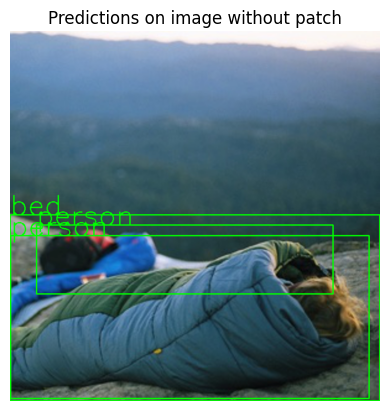

In [23]:
results = detector.predict(images[:1])
for i in range(len(results)):
    preds = extract_predictions(results[i], 0.45)
    im = (invTrans(torch.from_numpy(images[:1]))[i].numpy().transpose(1,2,0)*255).astype(np.uint8)
    plot_image_with_boxes(img=im.copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")


In [5]:
from art.estimators.object_detection.pytorch_detr import undo_rescale_bboxes
for i, bbox in enumerate([undo_rescale_bboxes(target['boxes'], (800, 800)) for target in results]):
    results[i]['boxes'] = bbox
    
for i in range(len(results)):
    preds = extract_predictions(results[i], 0.8)
    im = (invTrans(torch.from_numpy(images[:1]))[i].numpy().transpose(1,2,0)*255).astype(np.uint8)
    plot_image_with_boxes(img=im.copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")

In [6]:
detector.loss_gradient(images[:1], [results[1]])

IndexError: list index out of range

In [22]:
(results[1]['boxes'][:, 2:]>= results[1]['boxes'][:, 2:]).all()

tensor(True)

In [8]:
assert (boxes2[:, 2:] >= boxes2[:, 2:]).all()

0.81

In [20]:
from art.estimators.object_detection.pytorch_detr import undo_rescale_bboxes
for i, bbox in enumerate([undo_rescale_bboxes(target['boxes'], (800, 800)) for target in results]):
    results[i]['boxes'] = bbox


In [13]:
results[0]['labels']

tensor([27,  1, 65,  1,  1,  1,  1, 44,  1, 65, 65, 27, 65, 65, 65,  1, 27, 18,
        18, 65, 65,  1, 65,  1, 18,  1, 65,  1,  1,  1,  1, 65, 65, 27, 65,  1,
         1,  1, 44, 18, 18, 65,  1, 65, 27,  1, 18,  1,  1, 27,  1, 18, 65,  1,
         1,  1, 27,  1,  1,  1,  1,  1, 65,  1, 65, 44,  1, 65,  1, 27, 27,  1,
        65,  1, 65,  1,  1, 27,  1, 27, 65,  1,  1,  1,  1, 65, 27,  1, 65,  1,
         1, 18,  1,  1,  1, 65, 27,  1,  1, 18])

/Users/kieranfraser/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


({'loss_ce': tensor(5.4362, grad_fn=<NllLoss2DBackward0>),
  'class_error': tensor(98.),
  'loss_bbox': tensor(1727.9027, grad_fn=<DivBackward0>),
  'loss_giou': tensor(1.1889, grad_fn=<DivBackward0>),
  'cardinality_error': tensor(98.)},
 tensor([[[[ 2.0605,  2.0605,  2.0605,  ...,  2.1804,  2.1804,  2.1804],
           [ 1.9920,  1.9920,  1.9920,  ...,  2.1804,  2.1804,  2.1804],
           [ 1.8722,  1.8722,  1.8722,  ...,  2.1804,  2.1804,  2.1804],
           ...,
           [-0.8678, -0.8507, -0.7993,  ..., -1.2617, -1.3130, -1.3302],
           [-0.8507, -0.8335, -0.7822,  ..., -1.2788, -1.3302, -1.3473],
           [-0.8507, -0.8335, -0.7822,  ..., -1.2788, -1.3302, -1.3473]],
 
          [[ 2.1660,  2.1660,  2.1660,  ...,  2.2710,  2.2710,  2.2710],
           [ 2.1134,  2.1134,  2.1134,  ...,  2.2710,  2.2710,  2.2710],
           [ 2.0259,  2.0259,  2.0259,  ...,  2.2710,  2.2710,  2.2710],
           ...,
           [-0.4426, -0.4251, -0.3725,  ..., -0.9153, -0.9678, -0.985

In [5]:
undo_rescale_bboxes(results[0]['boxes'], (800,800))

tensor([[0.0153, 0.7278, 0.0308, 0.1487],
        [0.4644, 0.6010, 0.7794, 0.1556],
        [0.4997, 0.7742, 1.0000, 0.4528],
        [0.4720, 0.6094, 0.7947, 0.1658],
        [0.2297, 0.5988, 0.3062, 0.1380],
        [0.5153, 0.7500, 0.9140, 0.4489],
        [0.2969, 0.6088, 0.4442, 0.1450],
        [0.2010, 0.6702, 0.1018, 0.0407],
        [0.1821, 0.5942, 0.1658, 0.1107],
        [0.4998, 0.6233, 1.0000, 0.7574],
        [0.4995, 0.8314, 1.0000, 0.3371],
        [0.0283, 0.7528, 0.0567, 0.1940],
        [0.4998, 0.6474, 1.0000, 0.7023],
        [0.7173, 0.8930, 0.5253, 0.2178],
        [0.4991, 0.9781, 1.0000, 0.0443],
        [0.1468, 0.6774, 0.2939, 0.3106],
        [0.0232, 0.6513, 0.0464, 0.1294],
        [0.7923, 0.6461, 0.1490, 0.0941],
        [0.8107, 0.6822, 0.1515, 0.1086],
        [0.4999, 0.7240, 1.0000, 0.5512],
        [0.4997, 0.8023, 1.0000, 0.3955],
        [0.4986, 0.7344, 0.9997, 0.5254],
        [0.4997, 0.5129, 1.0000, 0.9558],
        [0.9880, 0.8817, 0.0241, 0

test using robust dpatch

In [91]:
import requests
url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
im = PIL.Image.open(requests.get(url, stream=True).raw)
im = transform(im).unsqueeze(0).numpy()

In [92]:
from art.attacks.evasion import RobustDPatch

attack = RobustDPatch(
            detector,
            patch_shape=(3,300,300),
            patch_location=(500, 200),
            crop_range=(0, 0),
            brightness_range=(1.0, 1.0),
            rotation_weights=(1, 0, 0, 0),
            sample_size=1,
            learning_rate=1.0,
            max_iter=50,
            batch_size=1,
            verbose=True,
        )

patch = attack.generate(x=im)
patched_image = attack.apply_patch(im, patch)

RobustDPatch iteration:   0%|          | 0/50 [00:00<?, ?it/s]

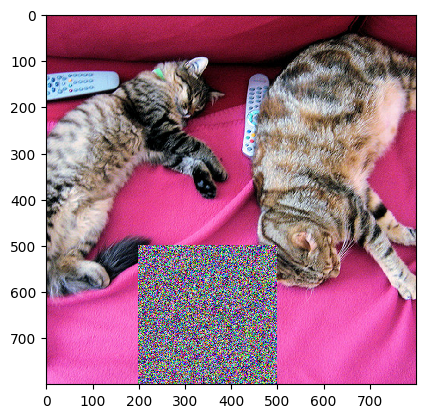

In [93]:
plt.imshow((invTrans(torch.from_numpy(patched_image[0])).numpy().transpose(1,2,0)*255).astype(np.uint8),
    interpolation='nearest')

/Users/kieranfraser/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


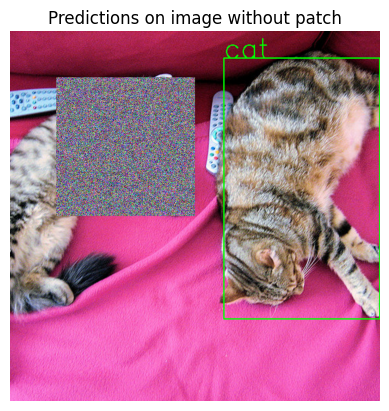

In [110]:
invTrans = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ],
                                                     std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                                transforms.Normalize(mean = [ -0.485, -0.456, -0.406 ],
                                                     std = [ 1., 1., 1. ]),
                               ])
results = detector.predict(x_patch)
for i in range(len(results)):
    preds = extract_predictions(results[i], 0.8)
    im = (invTrans(torch.from_numpy(x_patch))[i].numpy().transpose(1,2,0)*255).astype(np.uint8)
    plot_image_with_boxes(img=im.copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")

In [99]:
import requests
url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
im = PIL.Image.open(requests.get(url, stream=True).raw)
im = transform(im).unsqueeze(0).numpy()
x = im.copy()
y = detector.predict(x)

/Users/kieranfraser/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


Iteration: 0


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 5.807303428649902, 'loss_bbox': 1380.0469970703125, 'loss_giou': 1.0722928047180176}
Iteration: 1


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 5.903767108917236, 'loss_bbox': 1380.131591796875, 'loss_giou': 1.0722821950912476}
Iteration: 2


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 5.297731876373291, 'loss_bbox': 1380.10498046875, 'loss_giou': 1.0722965002059937}
Iteration: 3


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 7.560316562652588, 'loss_bbox': 1380.421875, 'loss_giou': 1.0722556114196777}
Iteration: 4


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 10.345065116882324, 'loss_bbox': 1380.8240966796875, 'loss_giou': 1.0722440481185913}
Iteration: 5


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 10.699606895446777, 'loss_bbox': 1380.5804443359375, 'loss_giou': 1.0722166299819946}
Iteration: 6


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 13.903914451599121, 'loss_bbox': 1380.9471435546875, 'loss_giou': 1.072230577468872}
Iteration: 7


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 14.755314826965332, 'loss_bbox': 1380.9158935546875, 'loss_giou': 1.0722272396087646}
Iteration: 8


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 12.310425758361816, 'loss_bbox': 1380.587158203125, 'loss_giou': 1.0722101926803589}
Iteration: 9


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 14.437688827514648, 'loss_bbox': 1380.970458984375, 'loss_giou': 1.072250485420227}
Iteration: 10


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 16.175823211669922, 'loss_bbox': 1380.8045654296875, 'loss_giou': 1.0722169876098633}
Iteration: 11


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 15.00485610961914, 'loss_bbox': 1380.694580078125, 'loss_giou': 1.0722033977508545}
Iteration: 12


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 17.133102416992188, 'loss_bbox': 1380.9747314453125, 'loss_giou': 1.0722153186798096}
Iteration: 13


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 16.679670333862305, 'loss_bbox': 1380.7965087890625, 'loss_giou': 1.0722203254699707}
Iteration: 14


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 7.748716831207275, 'loss_bbox': 1380.2293701171875, 'loss_giou': 1.0722098350524902}
Iteration: 15


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 19.205894470214844, 'loss_bbox': 1380.909423828125, 'loss_giou': 1.0722278356552124}
Iteration: 16


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 20.708454132080078, 'loss_bbox': 1380.8865966796875, 'loss_giou': 1.072232961654663}
Iteration: 17


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 10.934606552124023, 'loss_bbox': 1380.2841796875, 'loss_giou': 1.0721840858459473}
Iteration: 18


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 20.522218704223633, 'loss_bbox': 1380.9208984375, 'loss_giou': 1.0722358226776123}
Iteration: 19


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 19.838191986083984, 'loss_bbox': 1380.7738037109375, 'loss_giou': 1.0722416639328003}
Iteration: 20


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 14.682014465332031, 'loss_bbox': 1380.3409423828125, 'loss_giou': 1.072210669517517}
Iteration: 21


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 21.01407241821289, 'loss_bbox': 1380.9493408203125, 'loss_giou': 1.0722463130950928}
Iteration: 22


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 19.06591033935547, 'loss_bbox': 1380.70703125, 'loss_giou': 1.072210431098938}
Iteration: 23


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 15.81605339050293, 'loss_bbox': 1380.391357421875, 'loss_giou': 1.0721886157989502}
Iteration: 24


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 23.225725173950195, 'loss_bbox': 1381.000732421875, 'loss_giou': 1.0722428560256958}
Iteration: 25


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 16.395511627197266, 'loss_bbox': 1380.4298095703125, 'loss_giou': 1.0721946954727173}
Iteration: 26


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 22.21697425842285, 'loss_bbox': 1380.9359130859375, 'loss_giou': 1.0722655057907104}
Iteration: 27


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 21.032367706298828, 'loss_bbox': 1380.666259765625, 'loss_giou': 1.0722674131393433}
Iteration: 28


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 11.658970832824707, 'loss_bbox': 1380.3419189453125, 'loss_giou': 1.0721920728683472}
Iteration: 29


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 22.72881507873535, 'loss_bbox': 1381.031982421875, 'loss_giou': 1.0722546577453613}
Iteration: 30


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 20.263246536254883, 'loss_bbox': 1380.6759033203125, 'loss_giou': 1.0722233057022095}
Iteration: 31


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 18.981346130371094, 'loss_bbox': 1380.602294921875, 'loss_giou': 1.0721760988235474}
Iteration: 32


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 15.8775634765625, 'loss_bbox': 1380.3271484375, 'loss_giou': 1.0722066164016724}
Iteration: 33


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 24.25562286376953, 'loss_bbox': 1380.9693603515625, 'loss_giou': 1.0722657442092896}
Iteration: 34


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 19.243532180786133, 'loss_bbox': 1380.643310546875, 'loss_giou': 1.0721911191940308}
Iteration: 35


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 22.939674377441406, 'loss_bbox': 1380.990478515625, 'loss_giou': 1.0722236633300781}
Iteration: 36


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 20.595552444458008, 'loss_bbox': 1380.6656494140625, 'loss_giou': 1.072202205657959}
Iteration: 37


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 23.602182388305664, 'loss_bbox': 1380.9608154296875, 'loss_giou': 1.0722758769989014}
Iteration: 38


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 15.310652732849121, 'loss_bbox': 1380.3118896484375, 'loss_giou': 1.0721409320831299}
Iteration: 39


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 24.035789489746094, 'loss_bbox': 1381.05224609375, 'loss_giou': 1.0722395181655884}
Iteration: 40


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 21.738269805908203, 'loss_bbox': 1380.7010498046875, 'loss_giou': 1.072234869003296}
Iteration: 41


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 17.443445205688477, 'loss_bbox': 1380.4443359375, 'loss_giou': 1.0721396207809448}
Iteration: 42


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 22.964101791381836, 'loss_bbox': 1380.920166015625, 'loss_giou': 1.0722631216049194}
Iteration: 43


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 17.60550308227539, 'loss_bbox': 1380.4027099609375, 'loss_giou': 1.0721490383148193}
Iteration: 44


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 24.3056640625, 'loss_bbox': 1381.0517578125, 'loss_giou': 1.0722638368606567}
Iteration: 45


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 22.47420883178711, 'loss_bbox': 1380.8162841796875, 'loss_giou': 1.0722166299819946}
Iteration: 46


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 21.866077423095703, 'loss_bbox': 1380.6378173828125, 'loss_giou': 1.0721995830535889}
Iteration: 47


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 19.29219627380371, 'loss_bbox': 1380.4840087890625, 'loss_giou': 1.0721807479858398}
Iteration: 48


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 19.30031967163086, 'loss_bbox': 1380.51708984375, 'loss_giou': 1.0722050666809082}
Iteration: 49


RobustDPatch iteration:   0%|          | 0/1 [00:00<?, ?it/s]

{'loss_ce': 22.817033767700195, 'loss_bbox': 1380.9091796875, 'loss_giou': 1.0722752809524536}


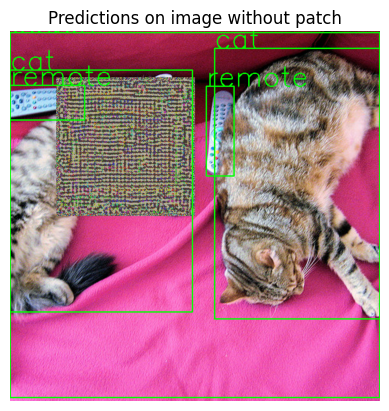

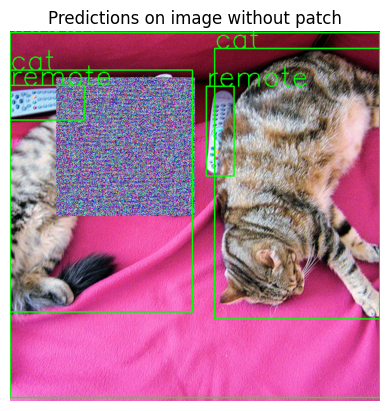

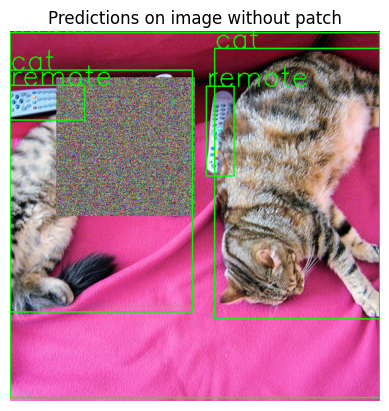

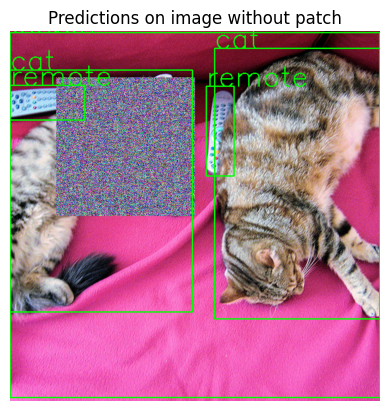

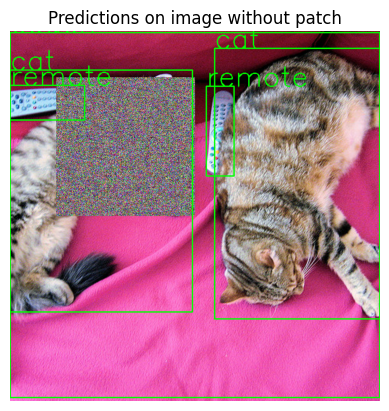

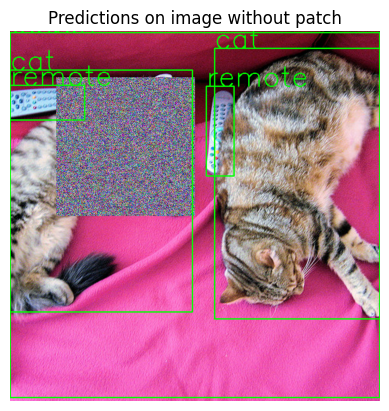

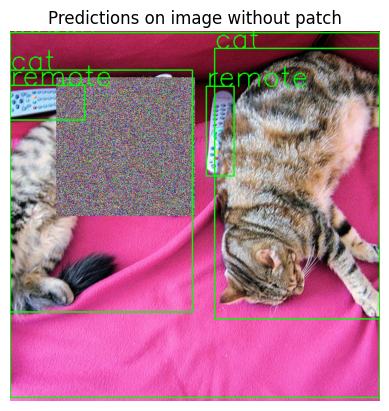

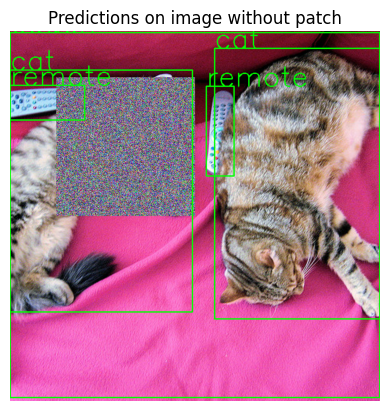

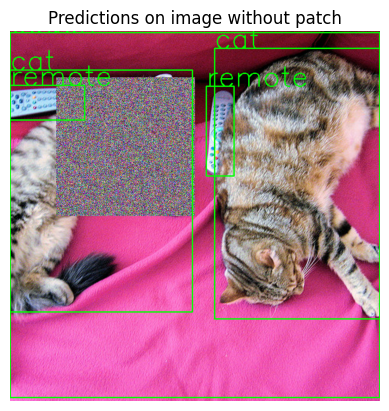

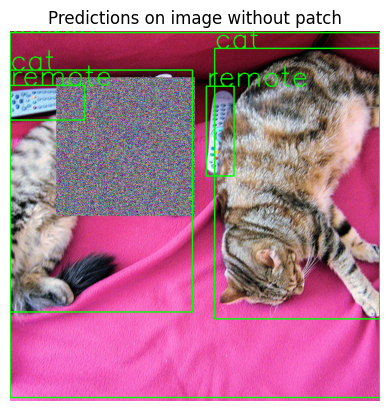

In [100]:
attack = RobustDPatch(
            detector,
            patch_shape=(3,300,300),
            patch_location=(100, 100),
            crop_range=(0, 0),
            brightness_range=(1.0, 1.0),
            rotation_weights=(1, 0, 0, 0),
            sample_size=1,
            learning_rate=1.0,
            max_iter=1,
            batch_size=1,
            verbose=True,
        )

loss_history = []
for i in range(50):
    print("Iteration:", i)
    patch = attack.generate(x)
    x_patch = attack.apply_patch(x)

    detector._model.train()
    loss_components, _, _ = detector._get_losses(x_patch, y)
    losses = {}
    for loss in loss_components.keys():
        if 'loss' in loss:
            losses[loss] = loss_components[loss].item()
    print(losses)
    loss_history.append(losses)

    if i%5==0:
        y = detector.predict(x)
        for i in range(len(y)):
            preds = extract_predictions(y[i], 0.8)
            im = (invTrans(torch.from_numpy(x_patch))[i].numpy().transpose(1,2,0)*255).astype(np.uint8)
            plot_image_with_boxes(img=im.astype(np.uint8).copy(), boxes=preds[1], pred_cls=preds[0], title="Predictions on image without patch")
        

<AxesSubplot: >

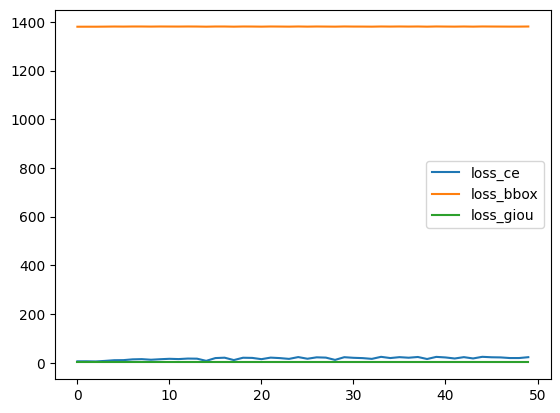

In [107]:
import pandas as pd
pd.DataFrame(loss_history).plot()

In [12]:
x = images[[0]].copy()
y = detector.predict(x)
loss_components, _, _ = detector._get_losses(x, y)
loss_components


/Users/kieranfraser/.cache/torch/hub/facebookresearch_detr_main/models/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)


{'loss_ce': tensor(5.4806, grad_fn=<NllLoss2DBackward0>),
 'class_error': tensor(96.),
 'loss_bbox': tensor(1727.9125, grad_fn=<DivBackward0>),
 'loss_giou': tensor(1.7154, grad_fn=<DivBackward0>),
 'cardinality_error': tensor(96.)}

In [13]:
x = images[[1]].copy()
y = detector.predict(x)
loss_components, _, _ = detector._get_losses(x, y)
loss_components

{'loss_ce': tensor(7.5652, grad_fn=<NllLoss2DBackward0>),
 'class_error': tensor(100.),
 'loss_bbox': tensor(1876.6542, grad_fn=<DivBackward0>),
 'loss_giou': tensor(1.7643, grad_fn=<DivBackward0>),
 'cardinality_error': tensor(100.)}

In [10]:
loss_components

{'loss_ce': tensor(6.0601, grad_fn=<NllLoss2DBackward0>),
 'class_error': tensor(98.),
 'loss_bbox': tensor(1727.9443, grad_fn=<DivBackward0>),
 'loss_giou': tensor(1.7154, grad_fn=<DivBackward0>),
 'cardinality_error': tensor(98.)}